In [1]:
using Pkg

In [2]:
ENV["PYTHON"] = "/home/tung/anaconda3/envs/celldancer/bin/python3"

"/home/tung/anaconda3/envs/celldancer/bin/python3"

In [3]:
Pkg.build("PyCall")

    Building Conda ─→ `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/b19db3927f0db4151cb86d073689f2428e524576/build.log`
    Building PyCall → `~/.julia/scratchspaces/44cfe95a-1eb2-52ea-b672-e2afdf69b78f/9816a3826b0ebf49ab4926e2b18842ad8b5c8f04/build.log`


In [4]:
using JuloVelo
using Plots

In [5]:
adata = read_adata("data/JuloVelo_pre.h5ad")

AnnData object 7202 ✕ 2000

In [6]:
adata.uns["iroot"] = 1

1

In [7]:
normalize(adata)

AnnData object 7202 ✕ 2000

In [8]:
filter_and_gene_kinetics_predetermination(adata; filter_criteria = 0.2)

[ Info: 915 genes are filtered due to low correlation between norm_u and norm_s
[ Info: See adata.var[!, "bad_correlation_genes"] for details
[ Info: 157 genes are filtered due to bad kinetics
[ Info: See adata.var[!, "bad_kinetics_genes"] for details
[ Info: 928 genes are used to infer velocity
[ Info: See adata.var[!, "train_genes"] for details


AnnData object 7202 ✕ 2000

In [9]:
reshape_data(adata)

[ Info: Data is reshaped to (2, 7202, 928)


AnnData object 7202 ✕ 2000

In [10]:
Kinetics = build_velocity_model(adata)

[ Info: Successfully initialize velocity model


Chain(
  SpatialDense(2 => 100, depth = 928, leakyrelu),  # 278_400 parameters
  SpatialDense(100 => 100, depth = 928, leakyrelu),  # 9_372_800 parameters
  SpatialDense(100 => 3, depth = 928, σ),  # 281_184 parameters
)                   # Total: 6 arrays, 9_932_384 parameters, 37.889 MiB.

In [11]:
density_sampling(adata)

[ Info: Sample 2400 cells


AnnData object 7202 ✕ 2000

In [12]:
train(adata, Kinetics)

[ Info: Training on gpu
[ Info: Training with Adam Optimizer
[ Info: TensorBoard logging at "/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/gastrulation_subset/saves/"
[ Info: Start training


Epoch: 0  Train: (cos_loss = 64070.727f0, penalty = 3417.7668f0, AvgMeanCos = 0.9712f0)
Epoch: 1  Train: (cos_loss = 62856.56f0, penalty = 3417.55f0, AvgMeanCos = 0.9718f0)
Epoch: 2  Train: (cos_loss = 61768.21f0, penalty = 3417.334f0, AvgMeanCos = 0.9723f0)
Epoch: 3  Train: (cos_loss = 60762.68f0, penalty = 3417.1177f0, AvgMeanCos = 0.9727f0)
Epoch: 4  Train: (cos_loss = 59840.4f0, penalty = 3416.9011f0, AvgMeanCos = 0.9731f0)
Epoch: 5  Train: (cos_loss = 58979.8f0, penalty = 3416.6843f0, AvgMeanCos = 0.9735f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 6  Train: (cos_loss = 58178.324f0, penalty = 3416.4668f0, AvgMeanCos = 0.9739f0)
Epoch: 7  Train: (cos_loss = 57429.03f0, penalty = 3416.2495f0, AvgMeanCos = 0.9742f0)
Epoch: 8  Train: (cos_loss = 56718.055f0, penalty = 3416.0315f0, AvgMeanCos = 0.9745f0)
Epoch: 9  Train: (cos_loss = 56053.863f0, penalty = 3415.8145f0, AvgMeanCos = 0.9748f0)
Epoch: 10  Train: (cos_loss = 55431.83f0, penalty = 3415.5967f0, AvgMeanCos = 0.9751f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 11  Train: (cos_loss = 54850.688f0, penalty = 3415.3796f0, AvgMeanCos = 0.9754f0)
Epoch: 12  Train: (cos_loss = 54297.133f0, penalty = 3415.162f0, AvgMeanCos = 0.9756f0)
Epoch: 13  Train: (cos_loss = 53784.16f0, penalty = 3414.944f0, AvgMeanCos = 0.9759f0)
Epoch: 14  Train: (cos_loss = 53293.035f0, penalty = 3414.7249f0, AvgMeanCos = 0.9761f0)
Epoch: 15  Train: (cos_loss = 52831.004f0, penalty = 3414.505f0, AvgMeanCos = 0.9763f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 16  Train: (cos_loss = 52405.832f0, penalty = 3414.2837f0, AvgMeanCos = 0.9765f0)
Epoch: 17  Train: (cos_loss = 51997.0f0, penalty = 3414.0615f0, AvgMeanCos = 0.9767f0)
Epoch: 18  Train: (cos_loss = 51604.35f0, penalty = 3413.8376f0, AvgMeanCos = 0.9768f0)
Epoch: 19  Train: (cos_loss = 51235.09f0, penalty = 3413.612f0, AvgMeanCos = 0.977f0)
Epoch: 20  Train: (cos_loss = 50880.914f0, penalty = 3413.3855f0, AvgMeanCos = 0.9772f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 21  Train: (cos_loss = 50549.125f0, penalty = 3413.1577f0, AvgMeanCos = 0.9773f0)
Epoch: 22  Train: (cos_loss = 50242.23f0, penalty = 3412.9272f0, AvgMeanCos = 0.9774f0)
Epoch: 23  Train: (cos_loss = 49947.13f0, penalty = 3412.6956f0, AvgMeanCos = 0.9776f0)
Epoch: 24  Train: (cos_loss = 49667.617f0, penalty = 3412.4631f0, AvgMeanCos = 0.9777f0)
Epoch: 25  Train: (cos_loss = 49409.117f0, penalty = 3412.2295f0, AvgMeanCos = 0.9778f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 26  Train: (cos_loss = 49166.754f0, penalty = 3411.9944f0, AvgMeanCos = 0.9779f0)
Epoch: 27  Train: (cos_loss = 48936.4f0, penalty = 3411.7576f0, AvgMeanCos = 0.978f0)
Epoch: 28  Train: (cos_loss = 48721.508f0, penalty = 3411.5205f0, AvgMeanCos = 0.9781f0)
Epoch: 29  Train: (cos_loss = 48519.336f0, penalty = 3411.2815f0, AvgMeanCos = 0.9782f0)
Epoch: 30  Train: (cos_loss = 48330.35f0, penalty = 3411.042f0, AvgMeanCos = 0.9783f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 31  Train: (cos_loss = 48152.598f0, penalty = 3410.8003f0, AvgMeanCos = 0.9784f0)
Epoch: 32  Train: (cos_loss = 47985.867f0, penalty = 3410.5576f0, AvgMeanCos = 0.9785f0)
Epoch: 33  Train: (cos_loss = 47825.37f0, penalty = 3410.314f0, AvgMeanCos = 0.9785f0)
Epoch: 34  Train: (cos_loss = 47672.793f0, penalty = 3410.069f0, AvgMeanCos = 0.9786f0)
Epoch: 35  Train: (cos_loss = 47526.492f0, penalty = 3409.8245f0, AvgMeanCos = 0.9787f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 36  Train: (cos_loss = 47388.234f0, penalty = 3409.578f0, AvgMeanCos = 0.9787f0)
Epoch: 37  Train: (cos_loss = 47256.508f0, penalty = 3409.3308f0, AvgMeanCos = 0.9788f0)
Epoch: 38  Train: (cos_loss = 47131.01f0, penalty = 3409.0833f0, AvgMeanCos = 0.9788f0)
Epoch: 39  Train: (cos_loss = 47008.547f0, penalty = 3408.8333f0, AvgMeanCos = 0.9789f0)
Epoch: 40  Train: (cos_loss = 46891.707f0, penalty = 3408.5835f0, AvgMeanCos = 0.9789f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 41  Train: (cos_loss = 46782.082f0, penalty = 3408.3325f0, AvgMeanCos = 0.979f0)
Epoch: 42  Train: (cos_loss = 46677.496f0, penalty = 3408.0803f0, AvgMeanCos = 0.979f0)
Epoch: 43  Train: (cos_loss = 46574.863f0, penalty = 3407.8276f0, AvgMeanCos = 0.9791f0)
Epoch: 44  Train: (cos_loss = 46477.816f0, penalty = 3407.574f0, AvgMeanCos = 0.9791f0)
Epoch: 45  Train: (cos_loss = 46383.363f0, penalty = 3407.32f0, AvgMeanCos = 0.9792f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 46  Train: (cos_loss = 46289.516f0, penalty = 3407.0652f0, AvgMeanCos = 0.9792f0)
Epoch: 47  Train: (cos_loss = 46200.406f0, penalty = 3406.8096f0, AvgMeanCos = 0.9793f0)
Epoch: 48  Train: (cos_loss = 46113.96f0, penalty = 3406.5527f0, AvgMeanCos = 0.9793f0)
Epoch: 49  Train: (cos_loss = 46032.43f0, penalty = 3406.2957f0, AvgMeanCos = 0.9793f0)
Epoch: 50  Train: (cos_loss = 45951.57f0, penalty = 3406.0364f0, AvgMeanCos = 0.9794f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 51  Train: (cos_loss = 45870.516f0, penalty = 3405.777f0, AvgMeanCos = 0.9794f0)
Epoch: 52  Train: (cos_loss = 45792.41f0, penalty = 3405.517f0, AvgMeanCos = 0.9794f0)
Epoch: 53  Train: (cos_loss = 45717.668f0, penalty = 3405.2556f0, AvgMeanCos = 0.9795f0)
Epoch: 54  Train: (cos_loss = 45648.355f0, penalty = 3404.994f0, AvgMeanCos = 0.9795f0)
Epoch: 55  Train: (cos_loss = 45581.47f0, penalty = 3404.7317f0, AvgMeanCos = 0.9795f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 56  Train: (cos_loss = 45514.82f0, penalty = 3404.4688f0, AvgMeanCos = 0.9796f0)
Epoch: 57  Train: (cos_loss = 45448.805f0, penalty = 3404.2048f0, AvgMeanCos = 0.9796f0)
Epoch: 58  Train: (cos_loss = 45385.945f0, penalty = 3403.9417f0, AvgMeanCos = 0.9796f0)
Epoch: 59  Train: (cos_loss = 45324.145f0, penalty = 3403.6765f0, AvgMeanCos = 0.9796f0)
Epoch: 60  Train: (cos_loss = 45266.305f0, penalty = 3403.4111f0, AvgMeanCos = 0.9797f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 61  Train: (cos_loss = 45208.15f0, penalty = 3403.1455f0, AvgMeanCos = 0.9797f0)
Epoch: 62  Train: (cos_loss = 45150.18f0, penalty = 3402.8796f0, AvgMeanCos = 0.9797f0)
Epoch: 63  Train: (cos_loss = 45097.637f0, penalty = 3402.6133f0, AvgMeanCos = 0.9798f0)
Epoch: 64  Train: (cos_loss = 45045.113f0, penalty = 3402.3467f0, AvgMeanCos = 0.9798f0)
Epoch: 65  Train: (cos_loss = 44993.19f0, penalty = 3402.08f0, AvgMeanCos = 0.9798f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 66  Train: (cos_loss = 44942.965f0, penalty = 3401.8137f0, AvgMeanCos = 0.9798f0)
Epoch: 67  Train: (cos_loss = 44893.965f0, penalty = 3401.5469f0, AvgMeanCos = 0.9798f0)
Epoch: 68  Train: (cos_loss = 44844.46f0, penalty = 3401.2793f0, AvgMeanCos = 0.9799f0)
Epoch: 69  Train: (cos_loss = 44795.742f0, penalty = 3401.0125f0, AvgMeanCos = 0.9799f0)
Epoch: 70  Train: (cos_loss = 44749.023f0, penalty = 3400.744f0, AvgMeanCos = 0.9799f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 71  Train: (cos_loss = 44701.695f0, penalty = 3400.476f0, AvgMeanCos = 0.9799f0)
Epoch: 72  Train: (cos_loss = 44655.754f0, penalty = 3400.2075f0, AvgMeanCos = 0.9799f0)
Epoch: 73  Train: (cos_loss = 44610.63f0, penalty = 3399.9375f0, AvgMeanCos = 0.98f0)
Epoch: 74  Train: (cos_loss = 44565.664f0, penalty = 3399.6685f0, AvgMeanCos = 0.98f0)
Epoch: 75  Train: (cos_loss = 44520.836f0, penalty = 3399.398f0, AvgMeanCos = 0.98f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 76  Train: (cos_loss = 44477.33f0, penalty = 3399.1277f0, AvgMeanCos = 0.98f0)
Epoch: 77  Train: (cos_loss = 44433.91f0, penalty = 3398.8572f0, AvgMeanCos = 0.98f0)
Epoch: 78  Train: (cos_loss = 44391.145f0, penalty = 3398.587f0, AvgMeanCos = 0.9801f0)
Epoch: 79  Train: (cos_loss = 44349.15f0, penalty = 3398.316f0, AvgMeanCos = 0.9801f0)
Epoch: 80  Train: (cos_loss = 44307.816f0, penalty = 3398.044f0, AvgMeanCos = 0.9801f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 81  Train: (cos_loss = 44269.703f0, penalty = 3397.7725f0, AvgMeanCos = 0.9801f0)
Epoch: 82  Train: (cos_loss = 44230.9f0, penalty = 3397.4995f0, AvgMeanCos = 0.9801f0)
Epoch: 83  Train: (cos_loss = 44193.652f0, penalty = 3397.2263f0, AvgMeanCos = 0.9802f0)
Epoch: 84  Train: (cos_loss = 44158.395f0, penalty = 3396.9531f0, AvgMeanCos = 0.9802f0)
Epoch: 85  Train: (cos_loss = 44122.38f0, penalty = 3396.6797f0, AvgMeanCos = 0.9802f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 86  Train: (cos_loss = 44088.02f0, penalty = 3396.4055f0, AvgMeanCos = 0.9802f0)
Epoch: 87  Train: (cos_loss = 44053.066f0, penalty = 3396.1316f0, AvgMeanCos = 0.9802f0)
Epoch: 88  Train: (cos_loss = 44017.168f0, penalty = 3395.8567f0, AvgMeanCos = 0.9802f0)
Epoch: 89  Train: (cos_loss = 43985.023f0, penalty = 3395.582f0, AvgMeanCos = 0.9803f0)
Epoch: 90  Train: (cos_loss = 43952.86f0, penalty = 3395.3064f0, AvgMeanCos = 0.9803f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 91  Train: (cos_loss = 43921.96f0, penalty = 3395.0315f0, AvgMeanCos = 0.9803f0)
Epoch: 92  Train: (cos_loss = 43891.906f0, penalty = 3394.756f0, AvgMeanCos = 0.9803f0)
Epoch: 93  Train: (cos_loss = 43861.582f0, penalty = 3394.4805f0, AvgMeanCos = 0.9803f0)
Epoch: 94  Train: (cos_loss = 43832.57f0, penalty = 3394.205f0, AvgMeanCos = 0.9803f0)
Epoch: 95  Train: (cos_loss = 43802.44f0, penalty = 3393.9297f0, AvgMeanCos = 0.9803f0)


[ Info: Model is saved in saves/Kinetics.bson


Epoch: 96  Train: (cos_loss = 43771.777f0, penalty = 3393.654f0, AvgMeanCos = 0.9803f0)
Epoch: 97  Train: (cos_loss = 43740.812f0, penalty = 3393.378f0, AvgMeanCos = 0.9804f0)
Epoch: 98  Train: (cos_loss = 43709.945f0, penalty = 3393.1016f0, AvgMeanCos = 0.9804f0)
Epoch: 99  Train: (cos_loss = 43678.375f0, penalty = 3392.8257f0, AvgMeanCos = 0.9804f0)
Epoch: 100  Train: (cos_loss = 43647.754f0, penalty = 3392.5493f0, AvgMeanCos = 0.9804f0)


[ Info: Model is saved in saves/Kinetics.bson


Chain(
  SpatialDense(2 => 100, depth = 928, leakyrelu),  # 278_400 parameters
  SpatialDense(100 => 100, depth = 928, leakyrelu),  # 9_372_800 parameters
  SpatialDense(100 => 3, depth = 928, σ),  # 281_184 parameters
)                   # Total: 6 arrays, 9_932_384 parameters, 37.889 MiB.

In [13]:
velocity_estimation(adata, Kinetics);

[ Info: Velocity saved in adata.uns["velocity"]
[ Info: kinetics saved in adata.uns["kinetics"]


In [14]:
compute_cell_velocity(adata; n_neighbors = 200);

In [15]:
estimate_pseudotime(adata, 3, n_repeat = 5; celltype = "celltype");

[ Info: Start estimate pseudotime, it may take a long time.
Generating Trajectories: 100%|████████| 36010/36010 [00:02<00:00, 13655.98it/s]


Pseudo random number generator seeds are set to:  [0, 1, 2, 3, 4]
There are 3 clusters.
[0 1 2]
--- 58.223681926727295 seconds ---


In [16]:
write_adata(adata, filename = "data/JuloVelo")

# Plot figure

In [17]:
palattes = Dict("Allantois"=> "#023fa5",
 "Anterior Primitive Streak"=> "#7d87b9",
 "Blood progenitors 1"=> "#bec1d4",
 "Blood progenitors 2"=> "#d6bcc0",
 "Caudal Mesoderm"=> "#bb7784",
 "Caudal epiblast"=> "#8e063b",
 "Caudal neurectoderm"=> "#4a6fe3",
 "Def. endoderm"=> "#8595e1",
 "Endothelium"=> "#b5bbe3",
 "Epiblast"=> "#e6afb9",
 "Erythroid1"=> "#e07b91",
 "ExE mesoderm"=> "#d33f6a",
 "Gut"=> "#11c638",
 "Haematoendothelial progenitors"=> "#8dd593",
 "Intermediate mesoderm"=> "#c6dec7",
 "Mesenchyme"=> "#ead3c6",
 "Mixed mesoderm"=> "#f0b98d",
 "Nascent mesoderm"=> "#ef9708",
 "Notochord"=> "#0fcfc0",
 "PGC"=> "#9cded6",
 "Paraxial mesoderm"=> "#d5eae7",
 "Pharyngeal mesoderm"=> "#f3e1eb",
 "Primitive Streak"=> "#f6c4e1",
 "Rostral neurectoderm"=> "#f79cd4",
 "Somitic mesoderm"=> "#7f7f7f",
 "Surface ectoderm"=> "#c7c7c7",
 "Visceral endoderm"=> "#1CE6FF")

Dict{String, String} with 27 entries:
  "Notochord"                      => "#0fcfc0"
  "Def. endoderm"                  => "#8595e1"
  "Somitic mesoderm"               => "#7f7f7f"
  "Caudal Mesoderm"                => "#bb7784"
  "Primitive Streak"               => "#f6c4e1"
  "Rostral neurectoderm"           => "#f79cd4"
  "Blood progenitors 2"            => "#d6bcc0"
  "Caudal epiblast"                => "#8e063b"
  "Haematoendothelial progenitors" => "#8dd593"
  "Surface ectoderm"               => "#c7c7c7"
  "Anterior Primitive Streak"      => "#7d87b9"
  "PGC"                            => "#9cded6"
  "Erythroid1"                     => "#e07b91"
  "Intermediate mesoderm"          => "#c6dec7"
  "Paraxial mesoderm"              => "#d5eae7"
  "Caudal neurectoderm"            => "#4a6fe3"
  "Visceral endoderm"              => "#1CE6FF"
  "Epiblast"                       => "#e6afb9"
  "Pharyngeal mesoderm"            => "#f3e1eb"
  "ExE mesoderm"                   => "#d33f6a"
  

In [18]:
function gene_plot(x, x̂; part = 20)
    x_range = Array(range(0, 1, part))
    y_range = Array(range(0, 1, part))
    
    arrow_vector = Array{Float32}(undef, 0, 2)
    point_vector = Array{Float32}(undef, 0, 2)
    
    for i in 1:part - 1
        for j in 1:part - 1
            index = intersect(findall(k -> (k .>= x_range[i]) & (k .<= x_range[i + 1]), x[2, :]), 
            findall(k -> (k .>= y_range[j]) & (k .<= y_range[j + 1]), x[1, :]))
            
            if length(index) > 0
                selected = x̂[:, index]
            else
                continue
            end
            
            selected_vector = sum(selected, dims = 2) ./ size(selected, 2)
            scale = maximum(abs, selected_vector) / (x_range[i + 1] - x_range[i])
            selected_vector = selected_vector ./ scale
            #println(selected_vector)
            xcenter = (x_range[i + 1] + x_range[i]) / 2
            ycenter = (y_range[j + 1] + y_range[j]) / 2
            xarrow = selected_vector[2]
            yarrow = selected_vector[1]
            
            arrow_vector = vcat(arrow_vector, vec([xarrow, yarrow])')
            point_vector = vcat(point_vector, vec([xcenter, ycenter])')
        end
    end
    
    return arrow_vector, point_vector
end

gene_plot (generic function with 1 method)

In [19]:
theme(:vibrant, framestyle = :zerolines, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

In [20]:
GR.setarrowsize(0.5)

In [21]:
X = adata.uns["X"];
velocity = adata.uns["velocity"]
genes = adata.var_names[adata.var[!, "train_genes"]]
celltype = adata.obs[!, "celltype"]
labels = sort(unique(celltype));

In [22]:
idx = findfirst(x -> x == "Dnmt3b", genes)

488

In [23]:
arrow_vector, point_vector = gene_plot(X[:, :, idx], velocity[:, :, idx])

([-0.05263157894736842 -0.042748881800013856; 0.01062379148064063 -0.05263157894736842; … ; -0.01285553657288949 -0.052631578947368474; -0.0047909954382980595 -0.052631578947368474], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.763157894736842; 0.9736842105263157 0.868421052631579])

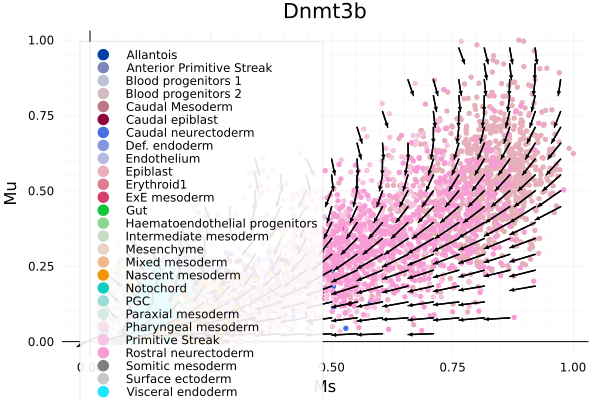

In [24]:
p1 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx], X[1, celltype .== label, idx], label = label, xlabel = "Ms", ylabel = "Mu", title = genes[idx], color = palattes[label])
end
quiver!(point_vector[:, 1], point_vector[:, 2], quiver = (arrow_vector[:, 1], arrow_vector[:, 2]), arrow = arrow(:closed), color = "#000000")

In [25]:
idx2 = findfirst(x -> x == "Rbms1", genes)

440

In [26]:
arrow_vector1, point_vector1 = gene_plot(X[:, :, idx2], velocity[:, :, idx2])

([-0.00754599571614742 0.05263157894736842; 0.019290195932794088 0.05263157894736842; … ; -0.052631578947368474 -0.04498332836576452; -0.01995391377994486 -0.052631578947368474], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.4473684210526315; 0.9736842105263157 0.7105263157894737])

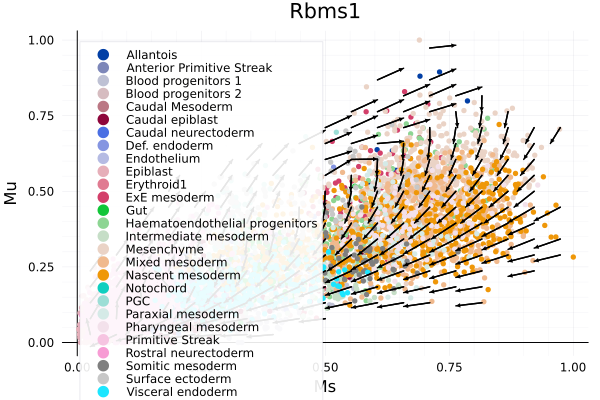

In [27]:
p2 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx2], X[1, celltype .== label, idx2], label = label, xlabel = "Ms", ylabel = "Mu", title = genes[idx2], color = palattes[label])
end
quiver!(point_vector1[:, 1], point_vector1[:, 2], quiver = (arrow_vector1[:, 1], arrow_vector1[:, 2]), arrow = arrow(:closed), color = "#000000")

In [28]:
idx3 = findfirst(x -> x == "Runx1", genes)

319

In [29]:
arrow_vector2, point_vector2 = gene_plot(X[:, :, idx3], velocity[:, :, idx3])

([0.0019499588531772226 0.05263157894736842; 0.026666153645427796 0.05263157894736842; … ; 0.025623100202583324 0.052631578947368474; 0.04312687998269676 0.052631578947368474], [0.02631578947368421 0.02631578947368421; 0.02631578947368421 0.07894736842105263; … ; 0.9736842105263157 0.4473684210526315; 0.9736842105263157 0.7105263157894737])

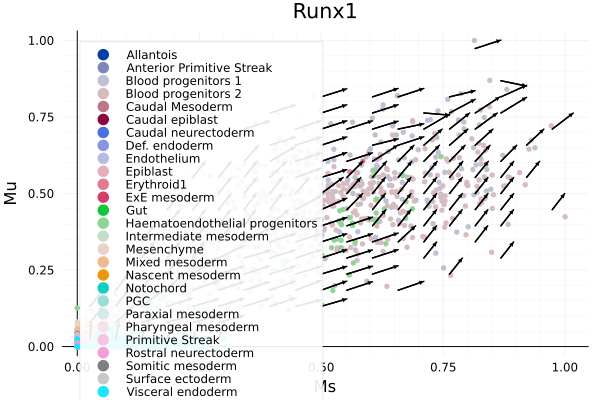

In [30]:
p3 = plot()
for label in labels
    scatter!(X[2, celltype .== label, idx3], X[1, celltype .== label, idx3], label = label, xlabel = "Ms", ylabel = "Mu", title = genes[idx3], color = palattes[label])
end
quiver!(point_vector2[:, 1], point_vector2[:, 2], quiver = (arrow_vector2[:, 1], arrow_vector2[:, 2]), arrow = arrow(:closed), color = "#000000")

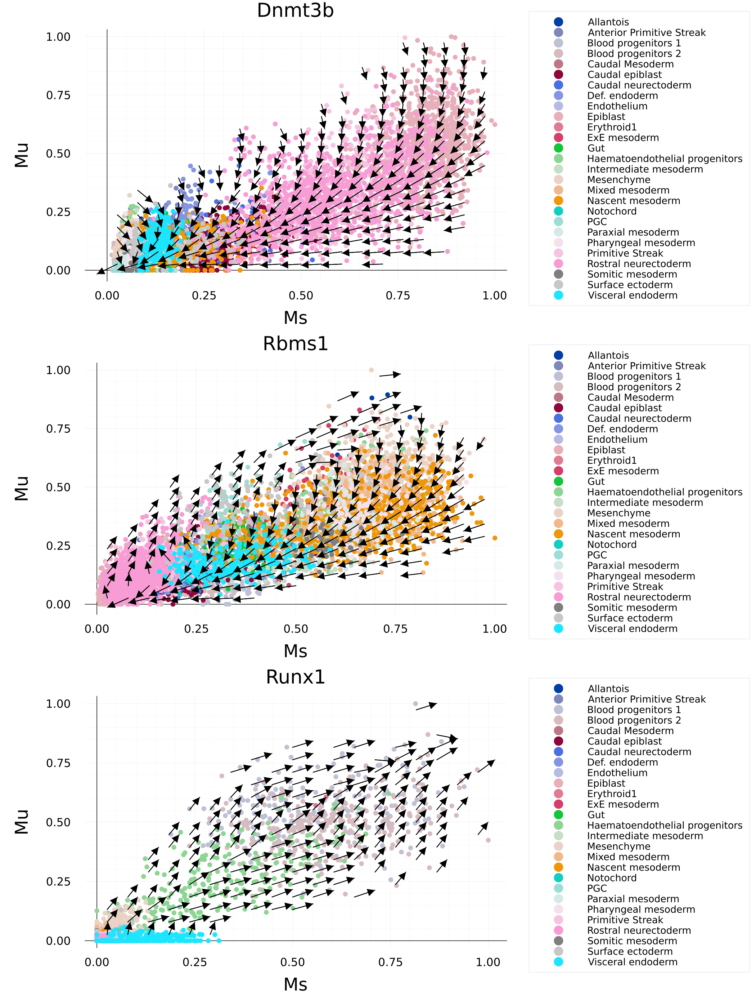

In [31]:
p = plot(p1, p2, p3, layout = (3, 1), size = (1400, 1850), dpi = 150, left_margins = 1.5Plots.cm, legendfontsize = 12, markersize = 5, legend = :outerright, 
    titlefontsize = 24, xtickfontsize = 14, ytickfontsize = 14, xguidefontsize = 22, yguidefontsize = 22)

In [32]:
savefig(p, "figure/JuloVelo_velocity_vector.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/gastrulation_subset/figure/JuloVelo_velocity_vector.png"

# Kinetics embedding

In [33]:
kinetics_embedding(adata; basis = "umap", min_dist = 0.5, n_neighbors = 25);

In [34]:
embedding = adata.obsm["kinetics_umap"];

In [35]:
celltype = adata.obs[!, "celltype"]
labels = sort(unique(celltype))

27-element Vector{String}:
 "Allantois"
 "Anterior Primitive Streak"
 "Blood progenitors 1"
 "Blood progenitors 2"
 "Caudal Mesoderm"
 "Caudal epiblast"
 "Caudal neurectoderm"
 "Def. endoderm"
 "Endothelium"
 "Epiblast"
 "Erythroid1"
 "ExE mesoderm"
 "Gut"
 ⋮
 "Mesenchyme"
 "Mixed mesoderm"
 "Nascent mesoderm"
 "Notochord"
 "PGC"
 "Paraxial mesoderm"
 "Pharyngeal mesoderm"
 "Primitive Streak"
 "Rostral neurectoderm"
 "Somitic mesoderm"
 "Surface ectoderm"
 "Visceral endoderm"

In [36]:
theme(:vibrant, framestyle = :axes, grid = true, markersize = 3, linewidth = 1.4, palette = :tab20) 

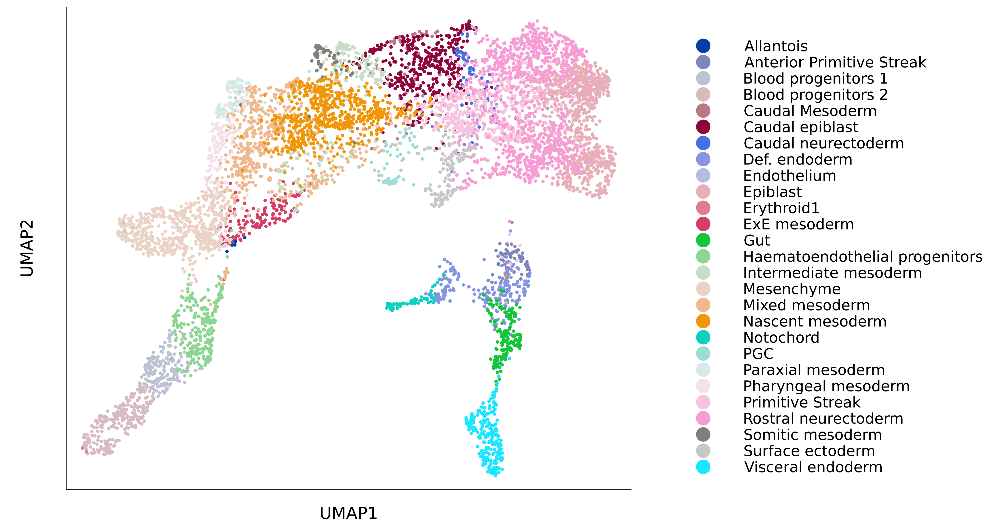

In [37]:
p = scatter(size = (1600, 850), fg_legend = :transparent, left_margins = 2.0Plots.cm, bottom_margins = 1.0Plots.cm, dpi = 300) #
for label in labels
    scatter!(embedding[celltype .== label, 1], embedding[celltype .== label, 2], label = label, legend=:outerright, legendfontsize = 16, color = palattes[label]
        , xlabel = "UMAP1", ylabel = "UMAP2", xtick = nothing, yticks = nothing, xguidefontsize = 18, yguidefontsize = 18)
end
p

In [38]:
savefig(p, "figure/gatrulation_E75_kinetic_embedding.png")

"/media/data/bmi111/KuanChiun/JuloVelo/thesis/results/gastrulation_subset/figure/gatrulation_E75_kinetic_embedding.png"